## Image segmentation with CamVid

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
# setup working directory to a folder in Google Drive
import os 
root_dir = "/content/drive/My Drive/"
# set folder name (this folder should exist in 'root_dir')
project_folder = "multisensory_data/"

def set_working_directory(project_folder):
  # change the OS to use your project folder as the working directory
  os.chdir(root_dir + project_folder)
  print('\nYour working directory was changed to ' + root_dir + project_folder + \
        "\n\nYou can also run !pwd to confirm the current working directory." )

set_working_directory(project_folder)

In [ ]:
%matplotlib inline

In [ ]:
# !pip install fastcore fastai --upgrade

In [ ]:
from fastai.basics import *
from fastai.callback.all import *
from fastai.vision.all import *
from nbdev.showdoc import *

In [ ]:
path = untar_data(URLs.CAMVID)
path.ls()

(#8) [Path('/Users/yangxiaohao/.fastai/data/camvid/.DS_Store'),Path('/Users/yangxiaohao/.fastai/data/camvid/images'),Path('/Users/yangxiaohao/.fastai/data/camvid/labels'),Path('/Users/yangxiaohao/.fastai/data/camvid/codes.txt'),Path('/Users/yangxiaohao/.fastai/data/camvid/valid_f.txt'),Path('/Users/yangxiaohao/.fastai/data/camvid/valid.txt'),Path('/Users/yangxiaohao/.fastai/data/camvid/images_f'),Path('/Users/yangxiaohao/.fastai/data/camvid/labels_f')]

In [ ]:
path_lbl = path/'labels'
path_img = path/'images'

## Data

In [ ]:
valid_fnames = (path/'valid.txt').read_text().split('\n')

In [ ]:
def ListSplitter(valid_items):
    def _inner(items):
        val_mask = tensor([o.name in valid_items for o in items])
        return [~val_mask,val_mask]
    return _inner

In [ ]:
codes = np.loadtxt(path/'codes.txt', dtype=str)
codes

array(['Animal', 'Archway', 'Bicyclist', 'Bridge', 'Building', 'Car',
       'CartLuggagePram', 'Child', 'Column_Pole', 'Fence', 'LaneMkgsDriv',
       'LaneMkgsNonDriv', 'Misc_Text', 'MotorcycleScooter', 'OtherMoving',
       'ParkingBlock', 'Pedestrian', 'Road', 'RoadShoulder', 'Sidewalk',
       'SignSymbol', 'Sky', 'SUVPickupTruck', 'TrafficCone',
       'TrafficLight', 'Train', 'Tree', 'Truck_Bus', 'Tunnel',
       'VegetationMisc', 'Void', 'Wall'], dtype='<U17')

## Datasets

In [ ]:
camvid = DataBlock(blocks=(ImageBlock, MaskBlock(codes)),
                   get_items=get_image_files,
                   splitter=ListSplitter(valid_fnames),
                   get_y=lambda o: path/'labels'/f'{o.stem}_P{o.suffix}',
                   batch_tfms=[*aug_transforms(size=(360,480)), Normalize.from_stats(*imagenet_stats)])

dls = camvid.dataloaders(path/"images", bs=8)

In [ ]:
dls = SegmentationDataLoaders.from_label_func(path, bs=8,
    fnames = get_image_files(path/"images"), 
    label_func = lambda o: path/'labels'/f'{o.stem}_P{o.suffix}',                                     
    codes = codes,                         
    batch_tfms=[*aug_transforms(size=(360,480)), Normalize.from_stats(*imagenet_stats)])

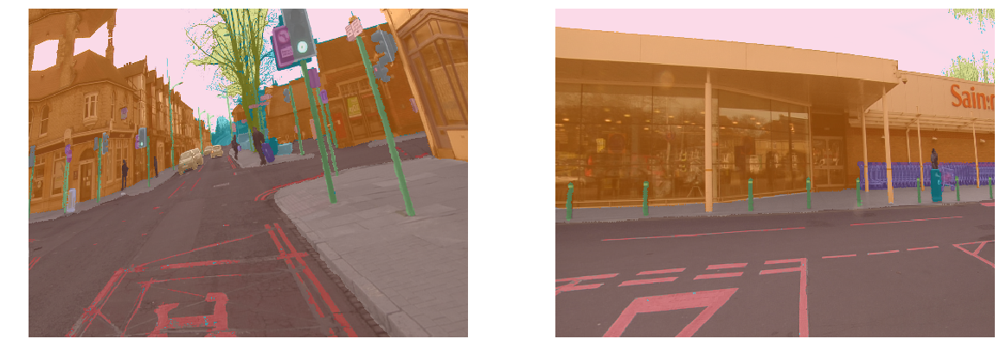

In [ ]:
dls.show_batch(max_n=2, figsize=(20, 7))

In [ ]:
dls.vocab = codes

## Model

In [ ]:
name2id = {v:k for k,v in enumerate(codes)}
void_code = name2id['Void']

def acc_camvid(input, target):
    target = target.squeeze(1)
    mask = target != void_code
    return (input.argmax(dim=1)[mask]==target[mask]).float().mean()

In [ ]:
opt_func = partial(Adam, lr=3e-3, wd=0.01)#, eps=1e-8)

learn = unet_learner(dls, resnet34, loss_func=CrossEntropyLossFlat(axis=1), opt_func=opt_func, path=path, metrics=acc_camvid,
                     norm_type=None, wd_bn_bias=True)

In [ ]:
# you need to set a right path 
learn.load('/path/to/new_stage-2');

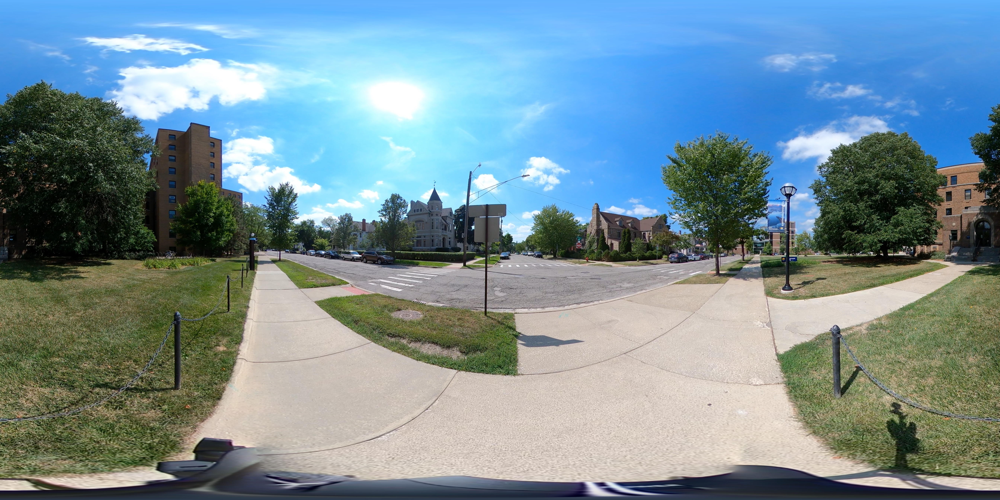

In [ ]:
# import a local image 
img = PILImage.create('101.jpeg')
img

In [ ]:
predic = learn.predict(img)

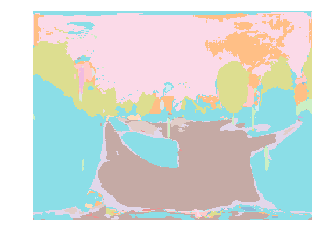

In [ ]:
predic[0].show()